# Simulation using Concord

In [4]:
%load_ext autoreload
%autoreload 2

In [5]:
import numpy as np
import scanpy as sc
import time
from pathlib import Path
import torch
import Concord as ccd
import warnings
warnings.filterwarnings('ignore')
%matplotlib inline

In [6]:
proj_name = "simulation_ccd_tree"
save_dir = f"../save/dev_{proj_name}-{time.strftime('%b%d')}/"
save_dir = Path(save_dir)
save_dir.mkdir(parents=True, exist_ok=True)
device = torch.device('cuda:3' if torch.cuda.is_available() else 'cpu')
print(device)
seed = 0
ccd.ul.set_seed(seed)

cpu


Concord.utils.simulation - INFO - Simulating tree with branching factor 2, depth 2, distribution: normal with mean expression 10 and dispersion 1.0.
Concord.utils.simulation - WARNING - Total number of genes will not be equal to num_genes due to program_decay < 1.
Concord.utils.simulation - INFO - Simulating batch-specific features effect on batch_1 by appending a set of batch-specific genes with normal distributed value with level 10 and dispersion 1.0.
Concord.utils.simulation - INFO - Simulating batch-specific features effect on batch_2 by appending a set of batch-specific genes with normal distributed value with level 10 and dispersion 1.0.


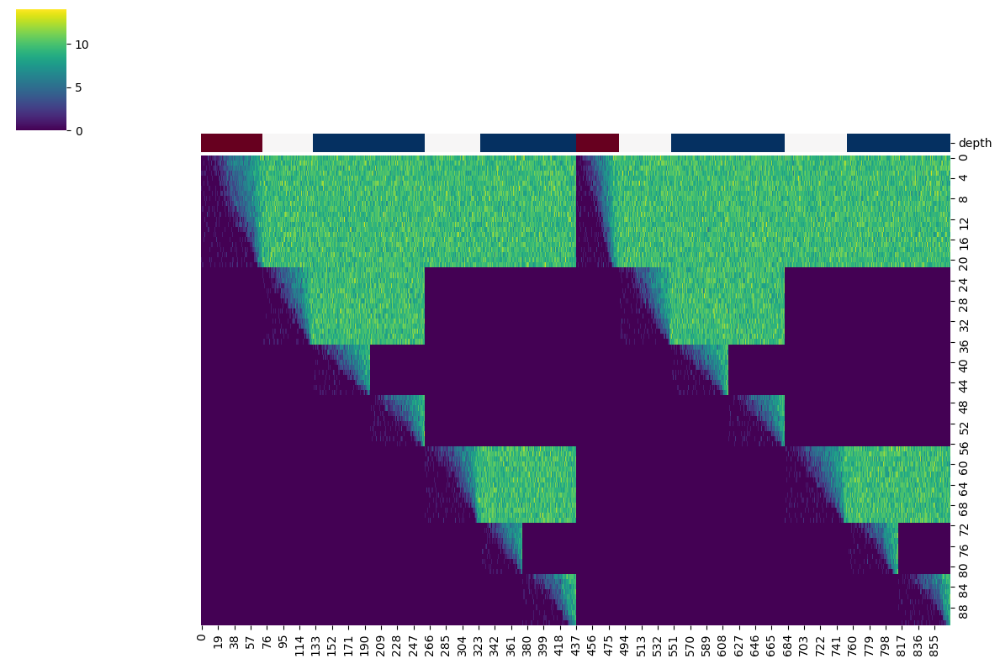

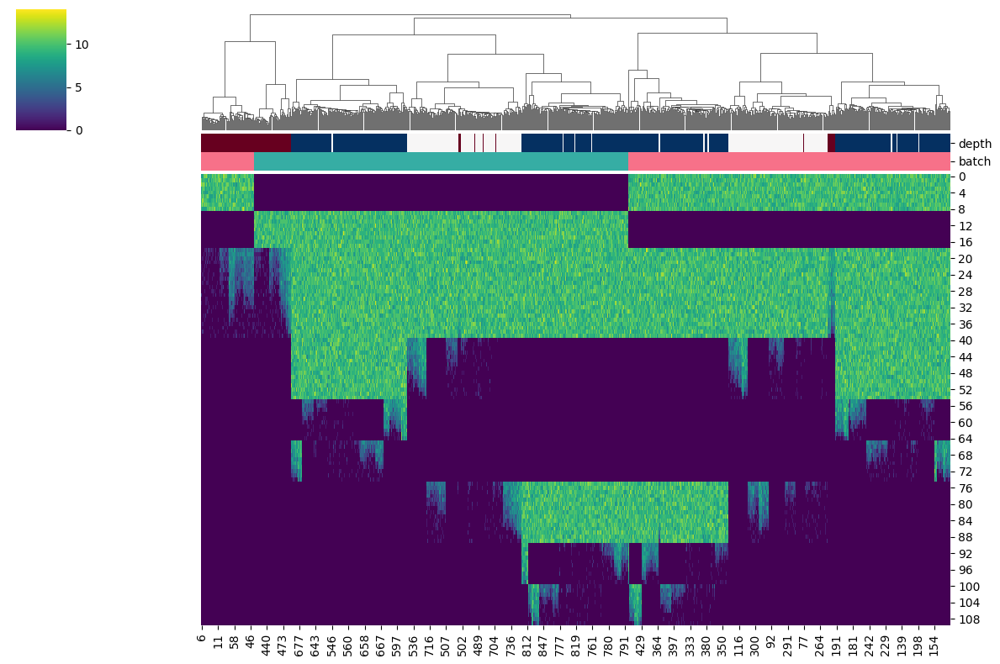

In [11]:
from Concord.utils.simulation import Simulation
#group_key = 'group'
group_key = 'depth'
batch_key = 'batch'
state_type = 'tree'
batch_type = 'batch_specific_features'
distribution = 'normal'
# Create an instance of the Simulation class
file_suffix = f"{state_type}_{batch_type}_{distribution}_{time.strftime('%b%d-%H%M')}"

sim = Simulation(n_cells=1000, n_genes=180, n_batches=2, n_states=3, 
                 state_type=state_type, 
                 state_distribution = distribution, 
                 state_level=10, 
                 state_min_level=0,
                 state_dispersion=1.0, 
                 program_structure='dimension_increase',
                 program_on_time_fraction=0.0,
                 trajectory_program_num=4,
                 trajectory_loop_to=1,
                 tree_branching_factor=2,
                 tree_depth=2,
                 tree_program_decay=0.7,
                 batch_distribution=distribution,
                 batch_type=batch_type, 
                 batch_level=[10,10], 
                 batch_dispersion=[1.0, 1.0], 
                 non_neg=True, to_int=True,
                 seed=42)

# Generate the simulated data
adata, adata_state = sim.simulate_data()
file_suffix = f"{state_type}_{batch_type}_{distribution}_{time.strftime('%b%d-%H%M')}"
ccd.pl.heatmap_with_annotations(adata_state, val='X', obs_keys=[group_key], cluster_cols=False, cluster_rows=False, value_annot=False, cmap='viridis', save_path=save_dir/f'state_heatmap_{file_suffix}.png') 
ccd.pl.heatmap_with_annotations(adata, val='X', obs_keys=[group_key, batch_key], cluster_cols=True, cluster_rows=False, value_annot=False, cmap='viridis', save_path=save_dir/f'heatmap_{file_suffix}.png') 

In [12]:
adata_state.X

array([[ 0,  0,  0, ...,  0,  0,  0],
       [ 0,  0,  0, ...,  0,  0,  0],
       [ 0,  1,  0, ...,  0,  0,  0],
       ...,
       [ 9,  9, 11, ...,  9,  7,  6],
       [ 9, 11, 11, ...,  9,  8,  7],
       [ 9, 10, 10, ...,  9, 10,  9]])

### NO batch effect, PCA and UMAP

In [13]:
n_pcs = min(adata_state.n_obs, adata_state.n_vars)-1
sc.pp.pca(adata_state, n_comps=n_pcs)
sc.pp.neighbors(adata_state, n_neighbors=30, n_pcs=n_pcs)
sc.tl.umap(adata_state, min_dist=0.5)

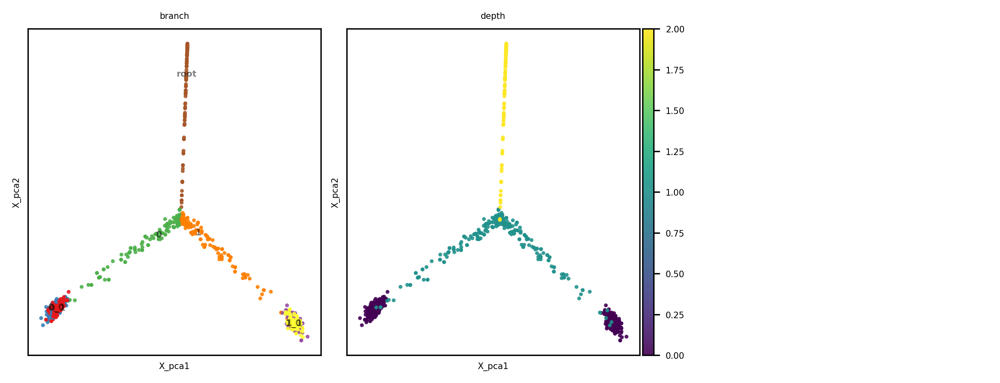

In [14]:
show_basis = 'X_pca'
show_cols = ['branch', 'depth']

ccd.pl.plot_embedding(
    adata_state, show_basis, show_cols, figsize=(8,3), dpi=300, ncols=3, font_size=5, point_size=20, legend_loc='on data',
    save_path=save_dir / f"nobatch_{show_basis}_{file_suffix}.png"
)

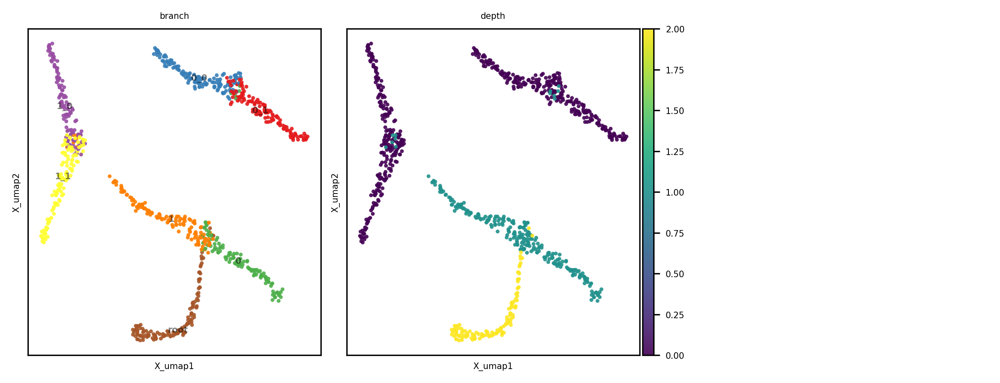

In [15]:
show_basis = 'X_umap'

ccd.pl.plot_embedding(
    adata_state, show_basis, show_cols, figsize=(8,3), dpi=300, ncols=3, font_size=5, point_size=20, legend_loc='on data',
    save_path=save_dir / f"nobatch_{show_basis}_{file_suffix}.png"
)

### No batch correction, PCA and UMAP

In [199]:
n_pcs = min(adata.n_obs, adata.n_vars)-1
sc.pp.pca(adata, n_comps=n_pcs)
sc.pp.neighbors(adata, n_neighbors=30, n_pcs=n_pcs)
sc.tl.umap(adata, min_dist=0.5)
adata.obsm["Unintegrated"] = adata.obsm["X_pca"]

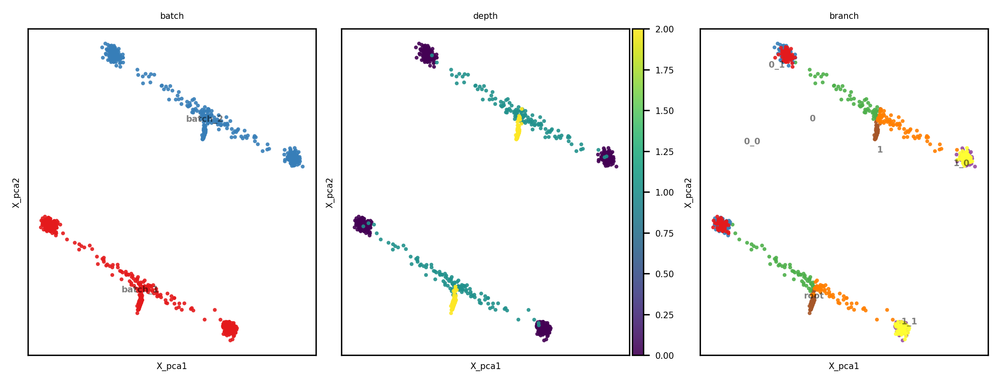

In [200]:
show_basis = 'X_pca'
show_cols = [batch_key, group_key, 'branch']

ccd.pl.plot_embedding(
    adata, show_basis, show_cols, figsize=(8,3), dpi=300, ncols=3, font_size=5, point_size=20, legend_loc='on data',
    save_path=save_dir / f"wtbatch_{show_basis}_{file_suffix}.png"
)

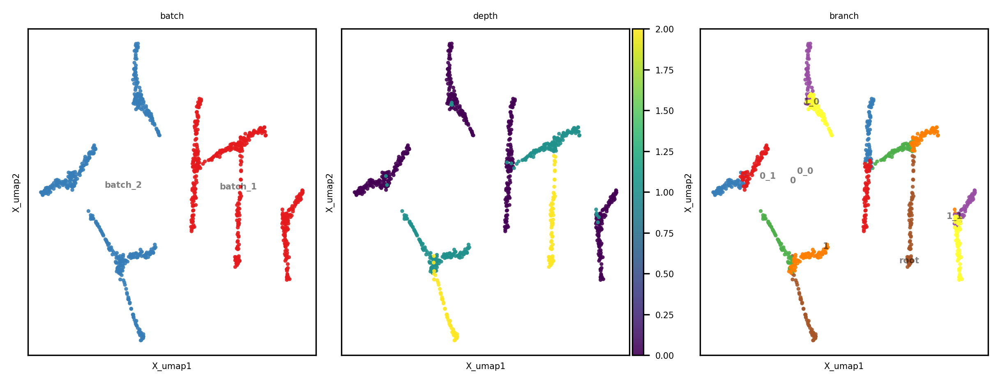

In [201]:
show_basis = 'X_umap'
ccd.pl.plot_embedding(
    adata, show_basis, show_cols, figsize=(8,3), dpi=300, ncols=3, font_size=5, point_size=20, legend_loc='on data',
    save_path=save_dir / f"wtbatch_{show_basis}_{file_suffix}.png"
)

### Concord

In [16]:
cur_ccd = ccd.Concord(adata=adata, 
                      input_feature=None, 
                      batch_size=32,
                      n_epochs=15,
                      lr=1e-2,
                      train_frac=1.0,
                      schedule_ratio = 0.97,
                      latent_dim=32, # latent dimension
                      encoder_dims = [64], # encoder architecture
                      decoder_dims = [64], # decoder architecture
                      norm_type = 'layer_norm',
                      use_importance_mask=False,
                      #importance_penalty_weight=1.0,
                      use_decoder=False,
                      domain_embedding_dim=8,
                      domain_key=batch_key, # key indicating batch
                      augmentation_mask_prob = 0.5, # augmentation mask probability, recommend between 0.1 and 0.7
                      clr_temperature = 0.5, # temperature for NT-Xent loss
                      seed=seed, # random seed
                      p_intra_domain = 1.0, # probability of intra-domain sampling
                      p_intra_knn=0.3,
                      sampler_knn = 128,
                      verbose=True, # print training progress
                      inplace=True, # whether to modify original adata, set to False if you want to keep all expressions
                      device=device, # device to run on
                      save_dir=save_dir # directory to save model checkpoints
                      ) 

# Encode data, saving the latent embedding in adata.obsm['Concord']
output_key = 'Concord'
cur_ccd.encode_adata(input_layer_key='X', output_key=output_key, preprocess=False)
# Save the latent embedding to a file, so that it can be loaded later
ccd.ul.save_obsm_to_hdf5(cur_ccd.adata, save_dir / f"obsm_{file_suffix}.h5")

Concord - WARNING - No input feature list provided. It is recommended to first select features using the command `concord.ul.select_features()`.
Concord - INFO - Proceeding with all 110 features in the dataset.
Concord - INFO - Column 'batch' is now of type: category
Concord - INFO - Encoder input dim: 110
Concord - INFO - Model loaded to device: cpu
Concord - INFO - Total number of parameters: 9392
Concord.model.anndataset - INFO - Initialized dataset with 874 samples. Data structure: ['input', 'domain', 'idx']
Concord.model.dataloader - INFO - PCA embedding not found in adata.obsm. Running PCA...
Concord.model.dataloader - INFO - PCA completed.
Concord.model.knn - WARNING - FAISS not found. Using sklearn for k-NN computation.
Concord.model.dataloader - INFO - Number of unique_domains: 2
Concord.model.dataloader - INFO - Final p_intra_domain values: batch_1: 1.00, batch_2: 1.00
p_intra_knn: 0.3
Concord - INFO - Starting epoch 1/15
Concord - INFO - Processing chunk 1/1 for epoch 1
Conc

Epoch 0 Training: 26it [00:00, 92.45it/s, loss=3.46]

Concord - INFO - Epoch   0 | Train Loss: 3.67, MSE: 0.00, CLASS: 0.00, CONTRAST: 3.67, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 2/15
Concord - INFO - Processing chunk 1/1 for epoch 2


Concord - INFO - Number of samples in train_dataloader: 874


Epoch 1 Training: 100%|██████████| 26/26 [00:00<00:00, 114.04it/s, loss=3.26]

Concord - INFO - Epoch   1 | Train Loss: 3.38, MSE: 0.00, CLASS: 0.00, CONTRAST: 3.38, IMPORTANCE: 0.00


Concord - INFO - Starting epoch 3/15
Concord - INFO - Processing chunk 1/1 for epoch 3
Concord - INFO - Number of samples in train_dataloader: 874


Epoch 2 Training: 100%|██████████| 26/26 [00:00<00:00, 143.48it/s, loss=3.12]

Concord - INFO - Epoch   2 | Train Loss: 3.32, MSE: 0.00, CLASS: 0.00, CONTRAST: 3.32, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 4/15
Concord - INFO - Processing chunk 1/1 for epoch 4
Concord - INFO - Number of samples in train_dataloader: 874



Epoch 3 Training: 100%|██████████| 26/26 [00:00<00:00, 122.51it/s, loss=3.36]

Concord - INFO - Epoch   3 | Train Loss: 3.22, MSE: 0.00, CLASS: 0.00, CONTRAST: 3.22, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 5/15
Concord - INFO - Processing chunk 1/1 for epoch 5
Concord - INFO - Number of samples in train_dataloader: 874



Epoch 4 Training: 100%|██████████| 26/26 [00:00<00:00, 106.45it/s, loss=3.27]

Concord - INFO - Epoch   4 | Train Loss: 3.19, MSE: 0.00, CLASS: 0.00, CONTRAST: 3.19, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 6/15
Concord - INFO - Processing chunk 1/1 for epoch 6
Concord - INFO - Number of samples in train_dataloader: 874



Epoch 5 Training: 100%|██████████| 26/26 [00:00<00:00, 110.58it/s, loss=3.13]

Concord - INFO - Epoch   5 | Train Loss: 3.20, MSE: 0.00, CLASS: 0.00, CONTRAST: 3.20, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 7/15
Concord - INFO - Processing chunk 1/1 for epoch 7


Concord - INFO - Number of samples in train_dataloader: 874


Epoch 6 Training: 100%|██████████| 26/26 [00:00<00:00, 141.92it/s, loss=3.19]

Concord - INFO - Epoch   6 | Train Loss: 3.17, MSE: 0.00, CLASS: 0.00, CONTRAST: 3.17, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 8/15
Concord - INFO - Processing chunk 1/1 for epoch 8


Concord - INFO - Number of samples in train_dataloader: 874


Epoch 7 Training: 100%|██████████| 26/26 [00:00<00:00, 106.40it/s, loss=3.12]

Concord - INFO - Epoch   7 | Train Loss: 3.15, MSE: 0.00, CLASS: 0.00, CONTRAST: 3.15, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 9/15
Concord - INFO - Processing chunk 1/1 for epoch 9
Concord - INFO - Number of samples in train_dataloader: 874



Epoch 8 Training: 100%|██████████| 26/26 [00:00<00:00, 83.88it/s, loss=3.19]

Concord - INFO - Epoch   8 | Train Loss: 3.15, MSE: 0.00, CLASS: 0.00, CONTRAST: 3.15, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 10/15
Concord - INFO - Processing chunk 1/1 for epoch 10
Concord - INFO - Number of samples in train_dataloader: 874



Epoch 9 Training: 100%|██████████| 26/26 [00:00<00:00, 108.88it/s, loss=3.12]

Concord - INFO - Epoch   9 | Train Loss: 3.12, MSE: 0.00, CLASS: 0.00, CONTRAST: 3.12, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 11/15
Concord - INFO - Processing chunk 1/1 for epoch 11
Concord - INFO - Number of samples in train_dataloader: 874



Epoch 10 Training: 100%|██████████| 26/26 [00:00<00:00, 131.00it/s, loss=3.25]

Concord - INFO - Epoch  10 | Train Loss: 3.11, MSE: 0.00, CLASS: 0.00, CONTRAST: 3.11, IMPORTANCE: 0.00


Concord - INFO - Starting epoch 12/15
Concord - INFO - Processing chunk 1/1 for epoch 12
Concord - INFO - Number of samples in train_dataloader: 874


Epoch 11 Training: 100%|██████████| 26/26 [00:00<00:00, 143.59it/s, loss=3.09]

Concord - INFO - Epoch  11 | Train Loss: 3.09, MSE: 0.00, CLASS: 0.00, CONTRAST: 3.09, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 13/15
Concord - INFO - Processing chunk 1/1 for epoch 13
Concord - INFO - Number of samples in train_dataloader: 874



Epoch 12 Training: 100%|██████████| 26/26 [00:00<00:00, 115.65it/s, loss=3.15]

Concord - INFO - Epoch  12 | Train Loss: 3.07, MSE: 0.00, CLASS: 0.00, CONTRAST: 3.07, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 14/15
Concord - INFO - Processing chunk 1/1 for epoch 14
Concord - INFO - Number of samples in train_dataloader: 874



Epoch 13 Training: 100%|██████████| 26/26 [00:00<00:00, 131.44it/s, loss=2.94]

Concord - INFO - Epoch  13 | Train Loss: 3.05, MSE: 0.00, CLASS: 0.00, CONTRAST: 3.05, IMPORTANCE: 0.00


Concord - INFO - Starting epoch 15/15
Concord - INFO - Processing chunk 1/1 for epoch 15
Concord - INFO - Number of samples in train_dataloader: 874


Epoch 14 Training: 100%|██████████| 26/26 [00:00<00:00, 136.10it/s, loss=3.01]

Concord - INFO - Epoch  14 | Train Loss: 2.99, MSE: 0.00, CLASS: 0.00, CONTRAST: 2.99, IMPORTANCE: 0.00


Concord - INFO - Model saved to ../save/dev_simulation_ccd_tree-Oct31/final_model.pth
Concord - INFO - Final model saved at: ../save/dev_simulation_ccd_tree-Oct31/final_model.pth; Configuration saved at: ../save/dev_simulation_ccd_tree-Oct31/config.json.
Concord.model.anndataset - INFO - Initialized dataset with 874 samples. Data structure: ['input', 'domain', 'idx']
Concord - INFO - Predicting for chunk 1/1
Concord - INFO - No domain specified for decoding. Using the same domain as the input data.


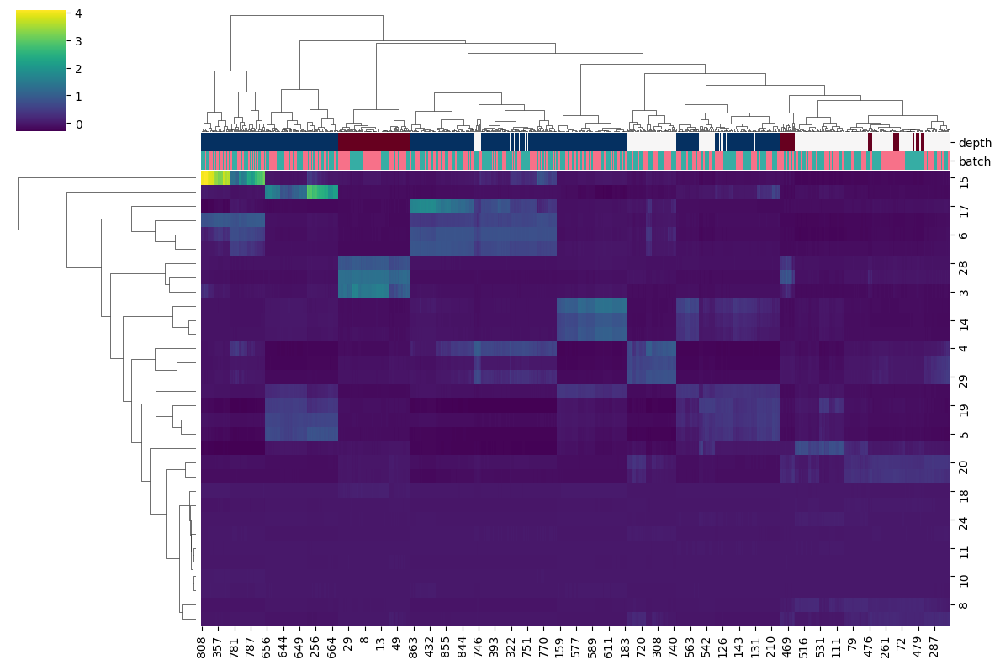

In [244]:
ccd.pl.heatmap_with_annotations(adata, val='Concord', obs_keys=[group_key, batch_key], cluster_cols=True, cluster_rows=True, cmap='viridis', save_path=save_dir/f'Concord_latent_heatmap_{file_suffix}.png')

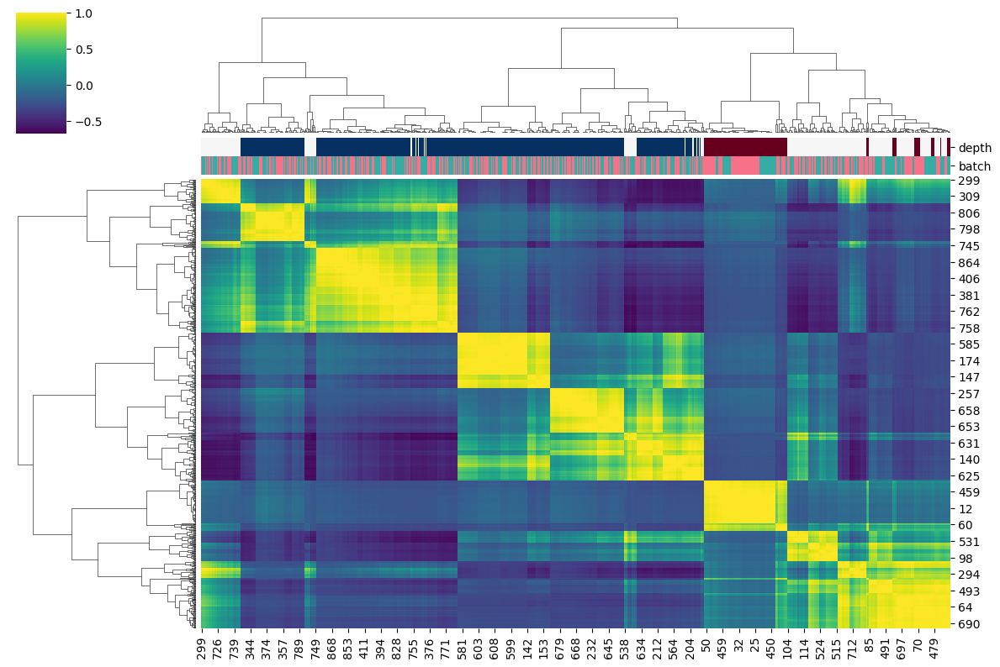

In [245]:
# Compute the correlation matrix
cos_mtx = ccd.ul.cosine_sim(adata.obsm['Concord'])
ccd.pl.heatmap_with_annotations(adata, val=cos_mtx,
                                obs_keys=[group_key, batch_key], cluster_cols=True, cluster_rows=True, cmap='viridis', save_path=save_dir/f'Concord_cosine_{file_suffix}.png')

Concord - INFO - PCA performed on source data with 31 components
Concord - INFO - PCA embedding stored in adata.obsm['Concord_PCA']


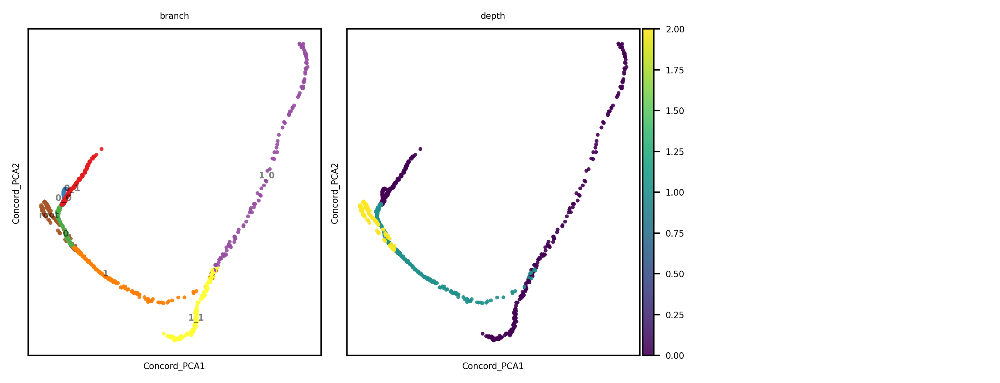

In [17]:
n_pc = min(adata.obsm[output_key].shape[1], adata.shape[0]) - 1
ccd.ul.run_pca(adata, source_key=output_key, result_key=f'{output_key}_PCA', n_pc=n_pc, random_state=seed)
show_basis = f'{output_key}_PCA'
ccd.pl.plot_embedding(
    adata, show_basis, show_cols, figsize=(8,3), dpi=300, ncols=3, font_size=5, point_size=20, legend_loc='on data',
    save_path=save_dir / f"{show_basis}_{file_suffix}.png"
)

Concord - INFO - UMAP embedding stored in adata.obsm['Concord_UMAP']


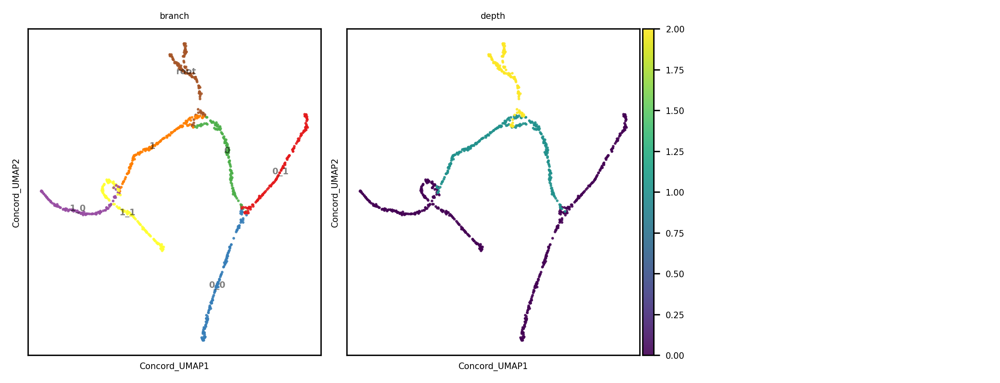

In [18]:
ccd.ul.run_umap(adata, source_key=output_key, umap_key=f'{output_key}_UMAP', n_components=2, n_neighbors=30, min_dist=0.5, metric='euclidean', random_state=seed)
output_key = 'Concord'
show_basis = f'{output_key}_UMAP'
ccd.pl.plot_embedding(
    adata, show_basis, show_cols, figsize=(8,3), dpi=300, ncols=3, font_size=5, point_size=10, legend_loc='on data',
    save_path=save_dir / f"{show_basis}_{file_suffix}.png"
)

In [248]:
ccd.ul.run_umap(adata, source_key='Concord', umap_key='Concord_UMAP_3D', n_components=3, n_neighbors=30, min_dist=0.5, metric='euclidean', random_state=seed)
ccd.pl.plot_embedding_3d(
    adata, basis='Concord_UMAP_3D', color_by=show_cols,
    save_path= save_dir / f"{show_basis}_{file_suffix}.html",
    point_size=5, opacity=0.8, width=1000, height=800
)

Concord - INFO - UMAP embedding stored in adata.obsm['Concord_UMAP_3D']
Concord - INFO - 3D plot saved to ../save/dev_simulation_ccd_tree-Oct29/Concord_UMAP_tree_batch_specific_features_normal_Oct31-1223_depth.html


Concord - INFO - 3D plot saved to ../save/dev_simulation_ccd_tree-Oct29/Concord_UMAP_tree_batch_specific_features_normal_Oct31-1223_batch.html


## Evaluation

### 1. Topological properties

#### 1.0 Persistent homology

In [208]:
adata.obsm

AxisArrays with keys: X_pca, X_umap, Unintegrated, Concord, Concord_PCA, Concord_UMAP, Concord_UMAP_3D

In [209]:
# Compute persistence diagram
#from Concord.utils.persistent_homology import compute_persistent_homology
homology_dimensions = [0,1,2]
dg_state = ccd.ul.compute_persistent_homology(adata_state, key='X_pca', homology_dimensions=homology_dimensions)
dg_pca = ccd.ul.compute_persistent_homology(adata, key='X_pca', homology_dimensions=homology_dimensions)
dg_ccd = ccd.ul.compute_persistent_homology(adata, key='Concord', homology_dimensions=homology_dimensions)

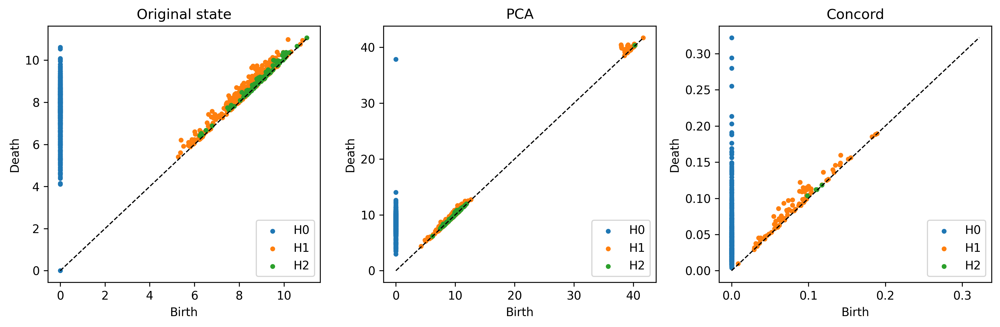

In [210]:
from matplotlib import pyplot as plt
fig, ax = plt.subplots(figsize=(12,4), ncols=3, dpi=300)
ccd.ul.plot_persistence_diagram(dg_state[0], ax=ax[0], marker_size=10, title='Original state', show=False)
ccd.ul.plot_persistence_diagram(dg_pca[0], ax=ax[1], marker_size=10, title='PCA', show=False)
ccd.ul.plot_persistence_diagram(dg_ccd[0], ax=ax[2], marker_size=10, title='Concord', show=False)
plt.tight_layout()
plt.savefig(save_dir / f"persistence_diagrams_{file_suffix}.png")
plt.show()

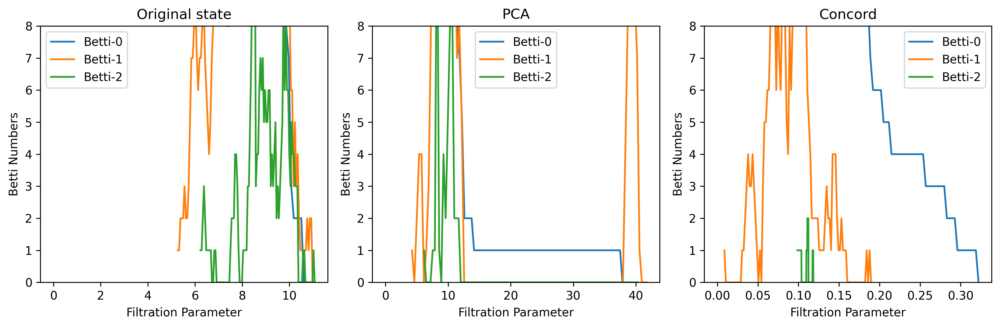

In [211]:
fig, ax = plt.subplots(figsize=(12,4), ncols=3, dpi=300)
ccd.ul.plot_betti_curves(dg_state, nbins=100, ax=ax[0], ymax=8, title='Original state', show=False)
ccd.ul.plot_betti_curves(dg_pca, nbins=100, ax=ax[1], ymax=8, title='PCA', show=False)
ccd.ul.plot_betti_curves(dg_ccd, nbins=100, ax=ax[2], ymax=8, title='Concord', show=False)
plt.tight_layout()
plt.savefig(save_dir / f"betti_curves_{file_suffix}.png")
plt.show()

In [212]:
from gtda.diagrams import PersistenceEntropy

PE = PersistenceEntropy()
pe_state = PE.fit_transform(dg_state)
pe_pca = PE.fit_transform(dg_pca)
pe_ccd = PE.fit_transform(dg_ccd)

print(f"PE state: {pe_state}, PE PCA: {pe_pca}, PE Concord: {pe_ccd}")

PE state: [[9.35681207 8.05897261 6.26430206]], PE PCA: [[9.73814701 8.34937988 6.4287099 ]], PE Concord: [[9.4512306  5.76967547 1.74891706]]


In [213]:
input_dim = 3
layout_dim = 2
color_by = 'depth'
cover_n_intervals = 20
cover_overlap_frac = 0.5
cluster_eps = 0.5
node_scale=30

basis = 'X_pca'
ccd.ul.plot_mapper_graph(adata_state, key=basis, filter_func='projection',
                            input_dim=input_dim, layout_dim=layout_dim, color_by=color_by,
                            cover_n_intervals=cover_n_intervals, cover_overlap_frac=cover_overlap_frac,
                            cluster_eps=cluster_eps, node_scale=node_scale, save_path=save_dir/f"mapper_{layout_dim}D_state_{basis}_{file_suffix}.html")
basis = 'X_pca'
ccd.ul.plot_mapper_graph(adata, key=basis, filter_func='projection',
                            input_dim=input_dim, layout_dim=layout_dim, color_by=color_by,
                            cover_n_intervals=cover_n_intervals, cover_overlap_frac=cover_overlap_frac,
                            cluster_eps=cluster_eps, node_scale=node_scale, save_path=save_dir/f"mapper_{layout_dim}D_{basis}_{file_suffix}.html")
basis = 'Concord'
ccd.ul.plot_mapper_graph(adata, key=basis, filter_func='PCA',
                            input_dim=input_dim, layout_dim=layout_dim, color_by=color_by,
                            cover_n_intervals=cover_n_intervals, cover_overlap_frac=cover_overlap_frac,
                            cluster_eps=cluster_eps, node_scale=node_scale, save_path=save_dir/f"mapper_{layout_dim}D_{basis}_{file_suffix}.html")

In [130]:
# adata_state.obs['batch_numeric'] = 0
# adata.obs['batch_numeric'] = adata.obs['batch'].astype('category').cat.codes

# input_dim = 3
# layout_dim = 2
# color_by = 'batch_numeric'
# cover_n_intervals = 20
# cover_overlap_frac = 0.5
# cluster_eps = 0.5
# node_scale=30
# cmap = 'RdBu'

# basis = 'X_pca'
# ccd.ul.plot_mapper_graph(adata_state, key=basis, filter_func='projection',
#                             input_dim=input_dim, layout_dim=layout_dim, color_by=color_by, cmap=cmap,
#                             cover_n_intervals=cover_n_intervals, cover_overlap_frac=cover_overlap_frac,
#                             cluster_eps=cluster_eps, node_scale=node_scale, save_path=save_dir/f"mapper_{layout_dim}D_state_{basis}_{file_suffix}.html")
# basis = 'X_pca'
# ccd.ul.plot_mapper_graph(adata, key=basis, filter_func='projection',
#                             input_dim=input_dim, layout_dim=layout_dim, color_by=color_by, cmap=cmap,
#                             cover_n_intervals=cover_n_intervals, cover_overlap_frac=cover_overlap_frac,
#                             cluster_eps=cluster_eps, node_scale=node_scale, save_path=save_dir/f"mapper_{layout_dim}D_{basis}_{file_suffix}.html")
# basis = 'Concord'
# ccd.ul.plot_mapper_graph(adata, key=basis, filter_func='PCA',
#                             input_dim=input_dim, layout_dim=layout_dim, color_by=color_by, cmap=cmap,
#                             cover_n_intervals=cover_n_intervals, cover_overlap_frac=cover_overlap_frac,
#                             cluster_eps=cluster_eps, node_scale=node_scale, save_path=save_dir/f"mapper_{layout_dim}D_{basis}_{file_suffix}.html")

In [132]:
# input_dim = 5
# layout_dim = 3
# color_by = 'depth'
# cover_n_intervals = 30
# cover_overlap_frac = 0.5
# cluster_eps = 0.5
# node_scale=30

# basis = 'X_pca'
# ccd.ul.plot_mapper_graph(adata_state, key=basis, filter_func='projection',
#                             input_dim=input_dim, layout_dim=layout_dim, color_by=color_by,
#                             cover_n_intervals=cover_n_intervals, cover_overlap_frac=cover_overlap_frac,
#                             cluster_eps=cluster_eps, node_scale=node_scale, save_path=save_dir/f"mapper_{layout_dim}D_state_{basis}_{file_suffix}.html")
# basis = 'X_pca'
# ccd.ul.plot_mapper_graph(adata, key=basis, filter_func='projection',
#                             input_dim=input_dim, layout_dim=layout_dim, color_by=color_by,
#                             cover_n_intervals=cover_n_intervals, cover_overlap_frac=cover_overlap_frac,
#                             cluster_eps=cluster_eps, node_scale=node_scale, save_path=save_dir/f"mapper_{layout_dim}D_{basis}_{file_suffix}.html")
# basis = 'Concord'
# ccd.ul.plot_mapper_graph(adata, key=basis, filter_func='PCA',
#                             input_dim=input_dim, layout_dim=layout_dim, color_by=color_by,
#                             cover_n_intervals=cover_n_intervals, cover_overlap_frac=cover_overlap_frac,
#                             cluster_eps=cluster_eps, node_scale=node_scale, save_path=save_dir/f"mapper_{layout_dim}D_{basis}_{file_suffix}.html")

#### 1.3 KNN graph

Concord - INFO - Building 15-NN graph using Concord basis
Concord - INFO - Graph has 874 nodes and 7053 edges
Concord - INFO - Computing kamada_kawai layout for visualization
Concord - INFO - Plotting 3D visualization


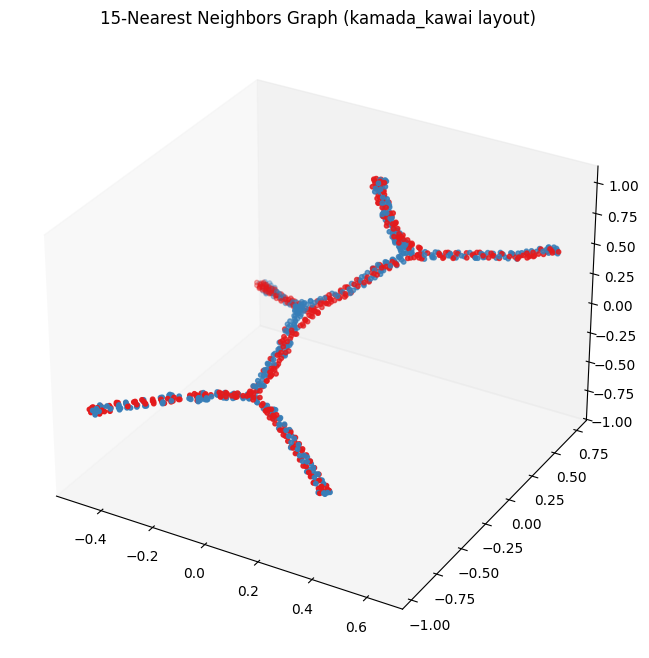

In [214]:
# ccd.pl.visualize_knn_graph(
#     adata, 
#     basis='Concord', 
#     color_by='batch', 
#     cmap='Set1',
#     k=15, 
#     dim=3,
#     layout='kamada_kawai', 
#     draw_edges=False, 
#     plotly=False
# )

Concord - INFO - Building 15-NN graph using Concord basis
Concord - INFO - Graph has 874 nodes and 7169 edges
Concord - INFO - Building 15-NN graph using Concord basis
Concord - INFO - Graph has 874 nodes and 7169 edges
Concord - INFO - Building 15-NN graph using Concord basis
Concord - INFO - Graph has 874 nodes and 7169 edges


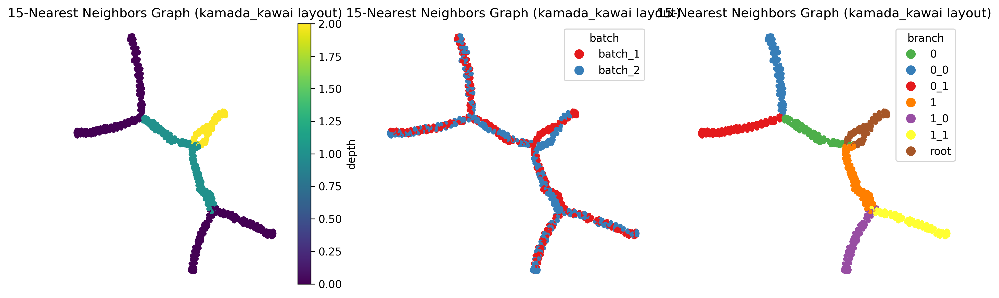

In [103]:
# # Knn graph
# fig, ax = plt.subplots(figsize=(12,4), ncols=3, dpi=300)

# ccd.pl.visualize_knn_graph(
#     adata, 
#     basis='Concord', 
#     color_by='depth', 
#     cmap='viridis',
#     node_size=2,
#     k=15, 
#     dim=2,
#     layout='kamada_kawai', 
#     draw_edges=False, 
#     plotly=False,
#     ax=ax[0]
# )

# ccd.pl.visualize_knn_graph(
#     adata, 
#     basis='Concord', 
#     color_by='batch', 
#     cmap='Set1',
#     node_size=2,
#     k=15, 
#     dim=2,
#     layout='kamada_kawai', 
#     draw_edges=False, 
#     plotly=False,
#     ax=ax[1]
# )

# ccd.pl.visualize_knn_graph(
#     adata, 
#     basis='Concord', 
#     color_by='branch', 
#     cmap='Set1',
#     node_size=2,
#     k=15, 
#     dim=2,
#     layout='kamada_kawai', 
#     draw_edges=False, 
#     plotly=False,
#     ax=ax[2]
# )

# plt.tight_layout()
# plt.savefig(save_dir / 'knn_graph.png', dpi=300)
# plt.show()

Concord - INFO - Building 15-NN graph using X_pca basis
Concord - INFO - Graph has 874 nodes and 7573 edges
Concord - INFO - Computing kamada_kawai layout for visualization
Concord - INFO - Plotting 2D visualization


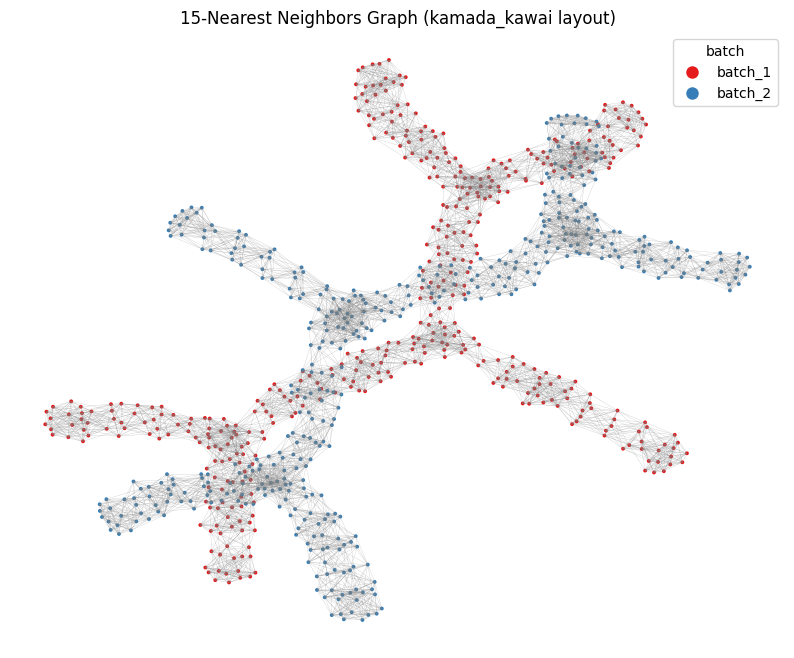

In [114]:
# ccd.pl.visualize_knn_graph(
#     adata, 
#     basis='X_pca', 
#     color_by='batch', 
#     cmap='Set1',
#     node_size=3,
#     k=15, 
#     dim=2,
#     layout='kamada_kawai', 
#     draw_edges=True, 
#     plotly=False
# )


#### KNN and PAGA

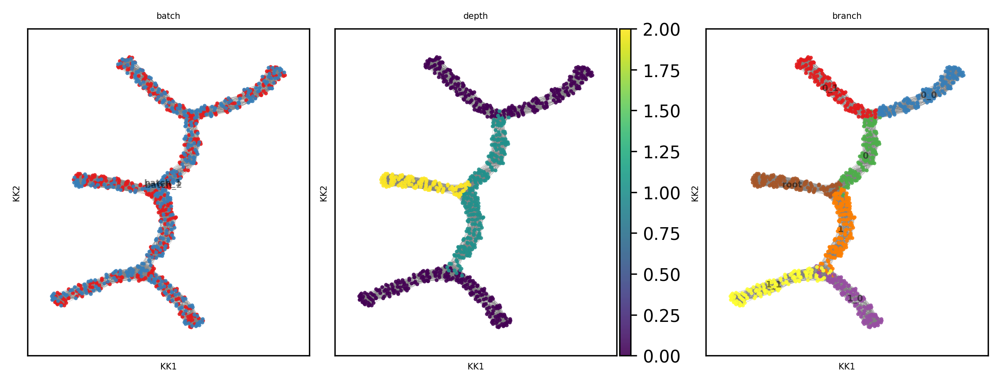

In [249]:
show_basis = 'Concord'
show_cols = [batch_key, group_key, 'branch']
layout='kk'
k=30

ccd.pl.plot_graph(
    adata, show_basis, k=k, layout=layout, edges=True,
    color_by=show_cols, figsize=(8,3), dpi=300, ncols=3, font_size=5, point_size=20, legend_loc='on data',
    save_path=save_dir / f"{k}nn_graph_{show_basis}_{file_suffix}.png"
)

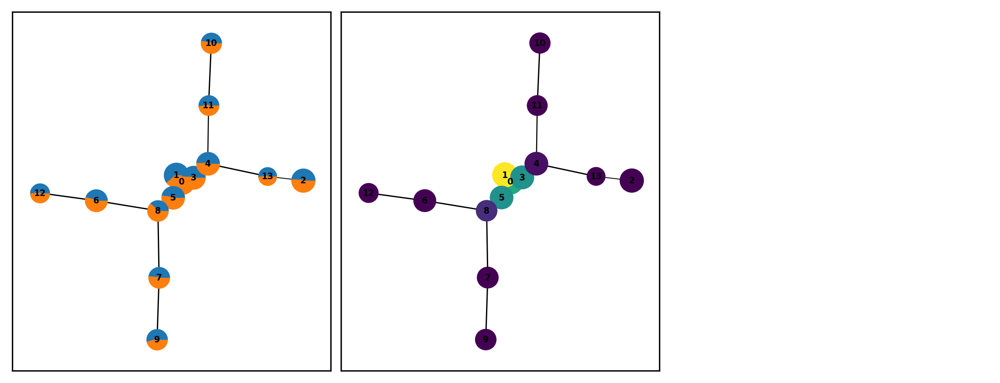

In [75]:
show_basis = 'Concord'
show_cols = [batch_key, group_key]
layout='kk'
k=30
resolution = .4
cluster_key = 'leiden_concord'

sc.tl.leiden(adata, resolution=resolution, key_added=cluster_key)
ccd.pl.plot_paga(
    adata, show_basis, k=k, 
    groups = cluster_key,
    resolution=.4, 
    layout=layout, 
    color_by=show_cols, 
    node_size_scale=1, edge_width_scale=0.1,
    figsize=(8,3), dpi=300, ncols=3, font_size=5, 
    save_path=save_dir / f"{k}nn_paga_{show_basis}_{file_suffix}.png"
)

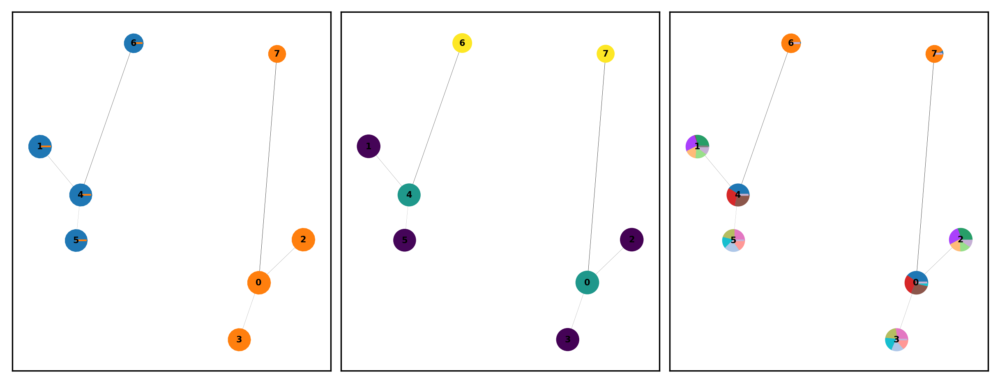

In [79]:
show_basis = 'X_pca'
show_cols = [batch_key, group_key, cluster_key]
layout='kk'
k=30

ccd.pl.plot_paga(
    adata, show_basis, k=k, 
    groups = 'leiden',
    resolution=.4, 
    layout=layout, 
    color_by=show_cols, 
    node_size_scale=1, edge_width_scale=0.1,
    figsize=(8,3), dpi=300, ncols=3, font_size=5, 
    save_path=save_dir / f"{k}nn_paga_{show_basis}_{file_suffix}.png"
)

### 2. Geometric properties

#### 2.0 Latent intepretation

In [231]:
decoder_ccd = ccd.Concord(adata=adata, 
                      input_feature=None, 
                      batch_size=32,
                      n_epochs=10,
                      lr=1e-2,
                      train_frac=1.0,
                      schedule_ratio = 0.97,
                      latent_dim=32, # latent dimension
                      encoder_dims = [64], # encoder architecture
                      decoder_dims = [64], # decoder architecture
                      norm_type = 'layer_norm',
                      use_importance_mask=False,
                      #importance_penalty_weight=1.0,
                      use_decoder=True,
                      domain_embedding_dim=8,
                      domain_key=batch_key, # key indicating batch
                      augmentation_mask_prob = 0.5, # augmentation mask probability, recommend between 0.1 and 0.7
                      clr_temperature = 0.5, # temperature for NT-Xent loss
                      seed=seed, # random seed
                      p_intra_domain = 1.0, # probability of intra-domain sampling
                      p_intra_knn=0.3,
                      sampler_knn = 128,
                      verbose=True, # print training progress
                      inplace=False, # whether to modify original adata, set to False if you want to keep all expressions
                      device=device, # device to run on
                      save_dir=save_dir # directory to save model checkpoints
                      ) 

# Encode data, saving the latent embedding in adata.obsm['Concord']
output_key = 'Concord'
decoder_ccd.encode_adata(input_layer_key='X', output_key=output_key, preprocess=False)
# Save the latent embedding to a file, so that it can be loaded later
ccd.ul.save_obsm_to_hdf5(decoder_ccd.adata, save_dir / f"obsm_{file_suffix}.h5")

Concord - WARNING - No input feature list provided. It is recommended to first select features using the command `concord.ul.select_features()`.
Concord - INFO - Proceeding with all 110 features in the dataset.
Concord - INFO - Column 'batch' is already of type: category
Concord - INFO - Unused levels dropped for column 'batch'.
Concord - INFO - Encoder input dim: 110
Concord - INFO - Decoder input dim: 40
Concord - INFO - Model loaded to device: cpu
Concord - INFO - Total number of parameters: 19294
Concord.model.anndataset - INFO - Initialized dataset with 874 samples. Data structure: ['input', 'domain', 'idx']
Concord.model.dataloader - INFO - Using existing embedding 'X_pca' from adata.obsm
Concord.model.knn - WARNING - FAISS not found. Using sklearn for k-NN computation.
Concord.model.dataloader - INFO - Number of unique_domains: 2
Concord.model.dataloader - INFO - Final p_intra_domain values: batch_1: 1.00, batch_2: 1.00
p_intra_knn: 0.3
Concord - INFO - Starting epoch 1/10
Conco

Epoch 0 Training: 0it [00:00, ?it/s, loss=37.9]

Epoch 0 Training: 26it [00:00, 63.55it/s, loss=16.5]

Concord - INFO - Epoch   0 | Train Loss:22.65, MSE:18.62, CLASS: 0.00, CONTRAST: 4.03, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 2/10
Concord - INFO - Processing chunk 1/1 for epoch 2


Concord - INFO - Number of samples in train_dataloader: 874


Epoch 1 Training: 100%|██████████| 26/26 [00:00<00:00, 72.48it/s, loss=8.59]

Concord - INFO - Epoch   1 | Train Loss:11.52, MSE: 7.92, CLASS: 0.00, CONTRAST: 3.60, IMPORTANCE: 0.00


Concord - INFO - Starting epoch 3/10
Concord - INFO - Processing chunk 1/1 for epoch 3
Concord - INFO - Number of samples in train_dataloader: 874


Epoch 2 Training: 100%|██████████| 26/26 [00:00<00:00, 64.05it/s, loss=7.5] 

Concord - INFO - Epoch   2 | Train Loss: 8.26, MSE: 4.84, CLASS: 0.00, CONTRAST: 3.43, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 4/10
Concord - INFO - Processing chunk 1/1 for epoch 4
Concord - INFO - Number of samples in train_dataloader: 874



Epoch 3 Training: 100%|██████████| 26/26 [00:00<00:00, 91.81it/s, loss=7.27]

Concord - INFO - Epoch   3 | Train Loss: 7.03, MSE: 3.67, CLASS: 0.00, CONTRAST: 3.36, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 5/10
Concord - INFO - Processing chunk 1/1 for epoch 5


Concord - INFO - Number of samples in train_dataloader: 874


Epoch 4 Training: 100%|██████████| 26/26 [00:00<00:00, 66.26it/s, loss=6.23]

Concord - INFO - Epoch   4 | Train Loss: 6.62, MSE: 3.30, CLASS: 0.00, CONTRAST: 3.32, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 6/10


Concord - INFO - Processing chunk 1/1 for epoch 6
Concord - INFO - Number of samples in train_dataloader: 874


Epoch 5 Training: 100%|██████████| 26/26 [00:00<00:00, 69.16it/s, loss=6.51]

Concord - INFO - Epoch   5 | Train Loss: 6.62, MSE: 3.28, CLASS: 0.00, CONTRAST: 3.33, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 7/10
Concord - INFO - Processing chunk 1/1 for epoch 7
Concord - INFO - Number of samples in train_dataloader: 874



Epoch 6 Training: 100%|██████████| 26/26 [00:00<00:00, 97.99it/s, loss=6.88]

Concord - INFO - Epoch   6 | Train Loss: 6.47, MSE: 3.17, CLASS: 0.00, CONTRAST: 3.30, IMPORTANCE: 0.00


Concord - INFO - Starting epoch 8/10
Concord - INFO - Processing chunk 1/1 for epoch 8
Concord - INFO - Number of samples in train_dataloader: 874


Epoch 7 Training: 100%|██████████| 26/26 [00:00<00:00, 66.18it/s, loss=5.62]

Concord - INFO - Epoch   7 | Train Loss: 6.15, MSE: 2.89, CLASS: 0.00, CONTRAST: 3.27, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 9/10
Concord - INFO - Processing chunk 1/1 for epoch 9
Concord - INFO - Number of samples in train_dataloader: 874



Epoch 8 Training: 100%|██████████| 26/26 [00:00<00:00, 103.87it/s, loss=6.4] 

Concord - INFO - Epoch   8 | Train Loss: 5.97, MSE: 2.69, CLASS: 0.00, CONTRAST: 3.28, IMPORTANCE: 0.00


Concord - INFO - Starting epoch 10/10
Concord - INFO - Processing chunk 1/1 for epoch 10
Concord - INFO - Number of samples in train_dataloader: 874


Epoch 9 Training: 100%|██████████| 26/26 [00:00<00:00, 71.56it/s, loss=5.78]

Concord - INFO - Epoch   9 | Train Loss: 5.96, MSE: 2.71, CLASS: 0.00, CONTRAST: 3.25, IMPORTANCE: 0.00
Concord - INFO - Model saved to ../save/dev_simulation_ccd_tree-Oct29/final_model.pth
Concord - INFO - Final model saved at: ../save/dev_simulation_ccd_tree-Oct29/final_model.pth; Configuration saved at: ../save/dev_simulation_ccd_tree-Oct29/config.json.
Concord.model.anndataset - INFO - Initialized dataset with 874 samples. Data structure: ['input', 'domain', 'idx']
Concord - INFO - Predicting for chunk 1/1
Concord - INFO - No domain specified for decoding. Using the same domain as the input data.


Concord - INFO - UMAP embedding stored in adata.obsm['Concord_UMAP']


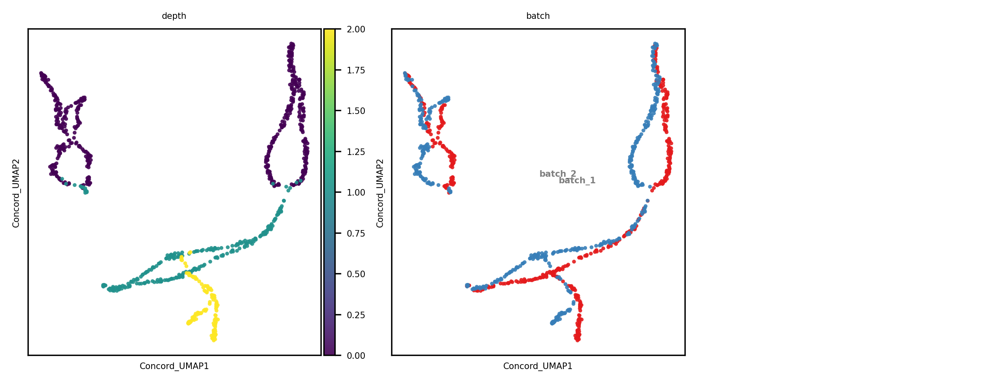

In [232]:
output_key = 'Concord'
ccd.ul.run_umap(decoder_ccd.adata, source_key=output_key, umap_key=f'{output_key}_UMAP', n_components=2, n_neighbors=30, min_dist=0.5, metric='euclidean', random_state=seed)
show_basis = f'{output_key}_UMAP'
show_cols = [group_key, batch_key]
ccd.pl.plot_embedding(
    decoder_ccd.adata, show_basis, show_cols, figsize=(8,3), dpi=300, ncols=3, font_size=5, point_size=20, legend_loc='on data',
    save_path=save_dir / f"{show_basis}_{file_suffix}.png"
)

In [235]:
# Predict and store the results
decoder_domain = 'batch_1'
#decoder_domain = 'batch_2'
encoded, decoded, class_preds, class_probs, class_true, latent_matrices = decoder_ccd.predict(decoder_ccd.loader, 
                                                                                        return_decoded=True, decoder_domain=decoder_domain,
                                                                                        return_latent=True,
                                                                                        return_class=False, return_class_prob=False)
save_key = f"{output_key}_decoded_{decoder_domain}"
decoder_ccd.adata.layers[save_key] = decoded
decoder_ccd.adata.layers

Concord - INFO - Predicting for chunk 1/1
Concord - INFO - Projecting data back to expression space of specified domain: batch_1


Layers with keys: Concord_decoded_batch_1, Concord_decoded_batch_2

Concord - INFO - UMAP embedding stored in adata.obsm['Concord_encoder_2_UMAP']


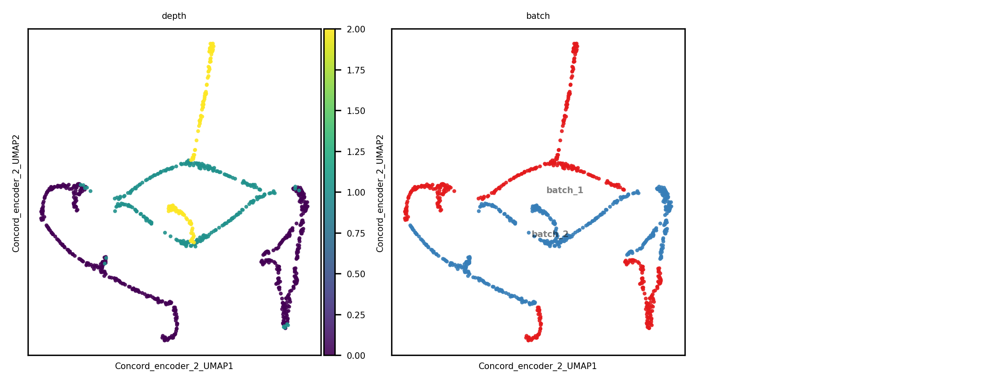

Concord - INFO - UMAP embedding stored in adata.obsm['Concord_encoder_6_UMAP']


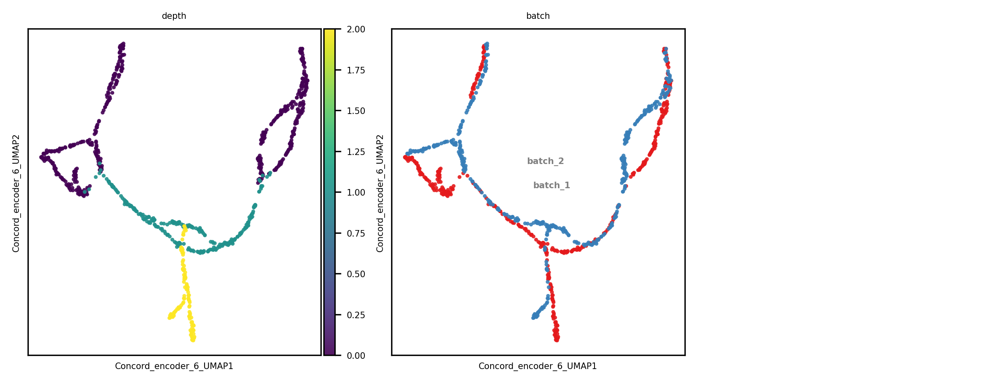

Concord - INFO - UMAP embedding stored in adata.obsm['Concord_decoder_2_UMAP']


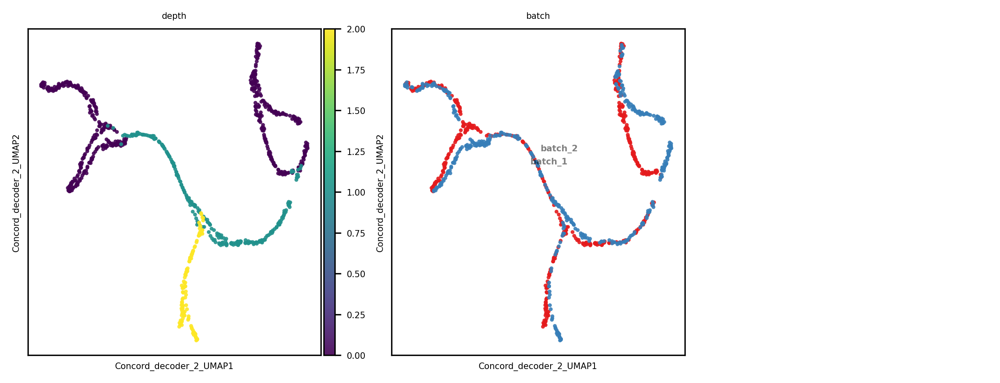

Concord - INFO - UMAP embedding stored in adata.obsm['Concord_decoder_5_UMAP']


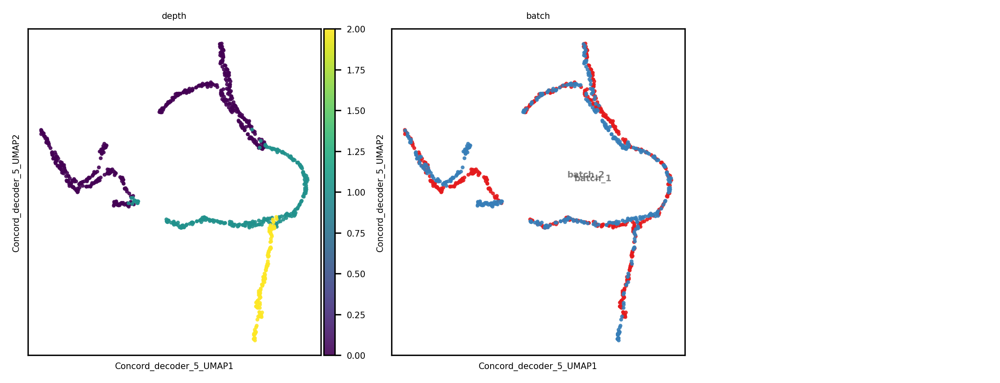

In [236]:
for output_key in ['Concord_encoder_2', 'Concord_encoder_6', 'Concord_decoder_2', 'Concord_decoder_5']:
    ccd.ul.run_umap(decoder_ccd.adata, source_key=output_key, umap_key=f'{output_key}_UMAP', n_components=2, n_neighbors=30, min_dist=0.5, metric='euclidean', random_state=seed)
    show_basis = f'{output_key}_UMAP'
    show_cols = [group_key, batch_key]
    ccd.pl.plot_embedding(
        decoder_ccd.adata, show_basis, show_cols, figsize=(8,3), dpi=300, ncols=3, font_size=5, point_size=20, legend_loc='on data',
        save_path=save_dir / f"{show_basis}_{file_suffix}.png"
    )

In [2]:
adata.X

NameError: name 'adata' is not defined

In [19]:
ccd.pl.plot_adata_layer_heatmaps(decoder_ccd.adata, ncells=None, ngenes=None, layers=['X', 'Concord_decoded_batch_1', 'Concord_decoded_batch_2'], 
                                 obs_keys=[group_key, batch_key], transpose=False, figsize=(6,6), cmap='viridis', dpi=300, save_path=save_dir/f'decoded_heatmap_{file_suffix}.png')

NameError: name 'decoder_ccd' is not defined

#### 2.2 Preservation of pairsie distances

In [20]:
from scipy.spatial.distance import pdist, squareform
from scipy.stats import spearmanr, pearsonr

# Compute pairwise distances in original space
dist_metric = 'cosine'
dist_original = pdist(adata_state.X, metric=dist_metric)  # original_data is your gene expression data
# Compute pairwise distances in latent space
dist_concord = pdist(adata.obsm['Concord'], metric=dist_metric) 
dist_pca = pdist(adata.obsm['X_pca'], metric=dist_metric)

In [117]:
from scipy.spatial.distance import pdist, squareform
from scipy.stats import spearmanr, pearsonr

# Compute pairwise distances in original space
dist_metric = 'cosine'
dist_original = pdist(adata_state.X, metric=dist_metric)  # original_data is your gene expression data
# Compute pairwise distances in latent space
dist_concord = pdist(adata.obsm['Concord'], metric=dist_metric) 
dist_pca = pdist(adata.obsm['X_pca'], metric=dist_metric)

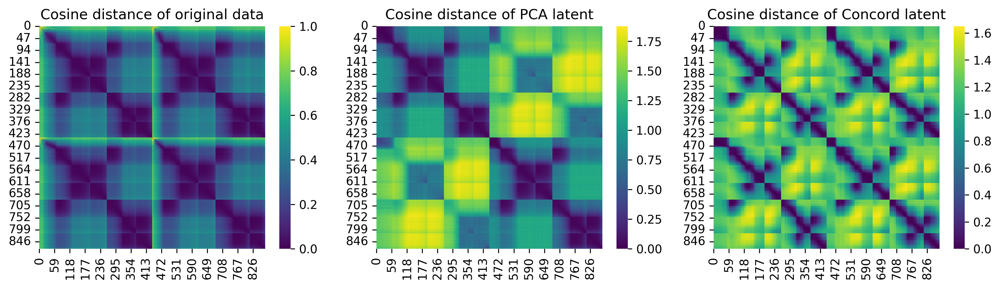

In [118]:
import seaborn as sns
import matplotlib.pyplot as plt
fig, axes = plt.subplots(1, 3, figsize=(12, 3.5), dpi=300)
sns.heatmap(squareform(dist_original), cmap='viridis', ax=axes[0])
axes[0].set_title(f'{dist_metric.capitalize()} distance of original data')
sns.heatmap(squareform(dist_pca), cmap='viridis', ax=axes[1])
axes[1].set_title(f'{dist_metric.capitalize()} distance of PCA latent')
sns.heatmap(squareform(dist_concord), cmap='viridis', ax=axes[2])
axes[2].set_title(f'{dist_metric.capitalize()} distance of Concord latent')
plt.tight_layout()
plt.savefig(save_dir / f"{dist_metric}_distance_heatmaps_{file_suffix}.png")

In [24]:
# Normalized stress
import numpy as np
from scipy.spatial.distance import pdist

def normalized_stress(X_high, X_low):
    dist_high = pdist(X_high)
    dist_low = pdist(X_low)
    stress = np.sqrt(np.sum((dist_high - dist_low) ** 2) / np.sum(dist_high ** 2))
    return stress

stress_ccd_state = normalized_stress(adata_state.X, adata.obsm['Concord'])
print(f'Normalized Stress comparing state and Concord: {stress_ccd_state:.4f}')
stress_pca_state = normalized_stress(adata_state.X, adata.obsm['X_pca'])
print(f'Normalized Stress comparing state and PCA: {stress_pca_state:.4f}')
stress_ccd_batch = normalized_stress(adata.X, adata.obsm['Concord'])
print(f'Normalized Stress comparing batch and Concord: {stress_ccd_batch:.4f}')
stress_pca_batch = normalized_stress(adata.X, adata.obsm['X_pca'])
print(f'Normalized Stress comparing batch and PCA: {stress_pca_batch:.4f}')

Normalized Stress comparing state and Concord: 0.9401
Normalized Stress comparing state and PCA: 0.3513
Normalized Stress comparing batch and Concord: 0.9522
Normalized Stress comparing batch and PCA: 0.0101


**Correlation of overall distance structure**

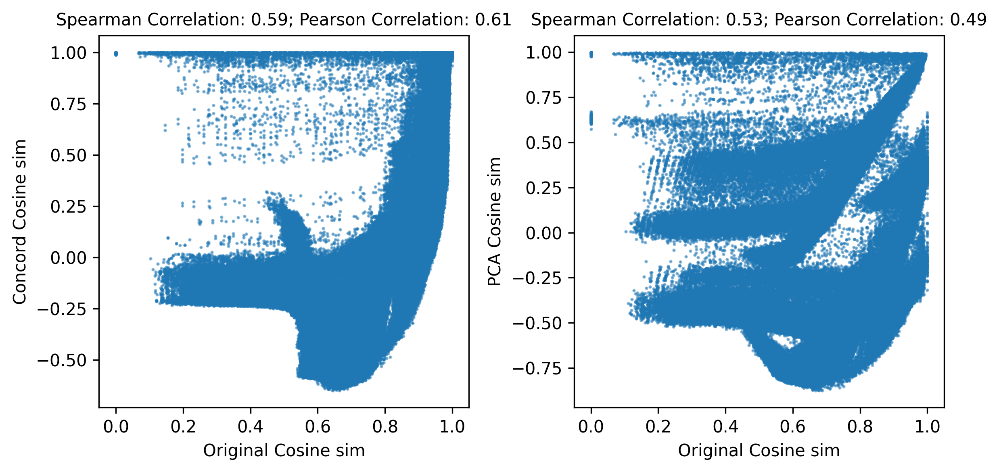

In [119]:
# Visualize the correlation between pairwise distances in original and latent space
import matplotlib.pyplot as plt
fig, axes = plt.subplots(1, 2, figsize=(8, 4), dpi=300)
axes[0].scatter(1-dist_original, 1-dist_concord, s=1, alpha=0.5)
axes[0].set_title(f'Spearman Correlation: {spearmanr(1-dist_original, 1-dist_concord)[0]:.2f}; Pearson Correlation: {pearsonr(dist_original, dist_concord)[0]:.2f}', fontsize=10)
axes[0].set_xlabel(f'Original {dist_metric.capitalize()} sim')
axes[0].set_ylabel(f'Concord {dist_metric.capitalize()} sim')
axes[1].scatter(1-dist_original, 1-dist_pca, s=1, alpha=0.5)
axes[1].set_title(f'Spearman Correlation: {spearmanr(1-dist_original, 1-dist_pca)[0]:.2f}; Pearson Correlation: {pearsonr(dist_original, dist_pca)[0]:.2f}', fontsize=10)
axes[1].set_xlabel(f'Original {dist_metric.capitalize()} sim')
axes[1].set_ylabel(f'PCA {dist_metric.capitalize()} sim')
plt.tight_layout()
plt.savefig(save_dir / f"{dist_metric}_distance_correlation_scatter_{file_suffix}.png")

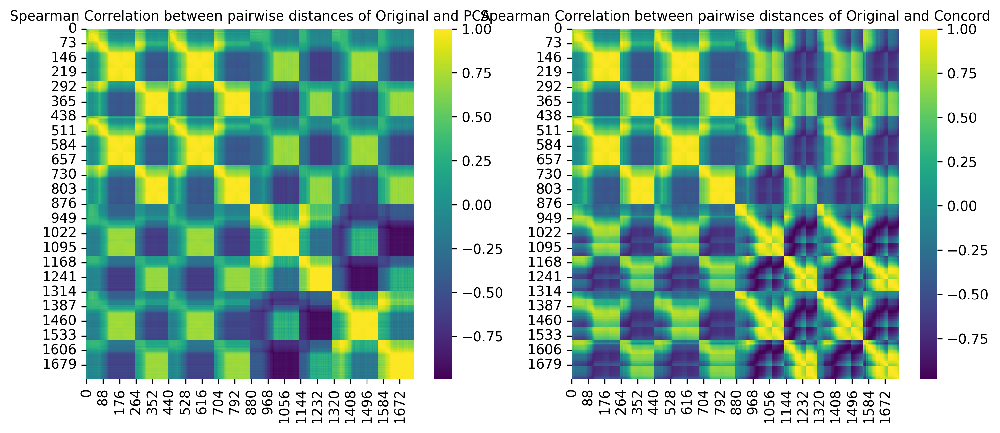

In [123]:
# Visualize distance Spearman correlation as heatmap
import seaborn as sns
corr_concord, _ = spearmanr(squareform(dist_original), squareform(dist_concord))
corr_batch, _ = spearmanr(squareform(dist_original), squareform(dist_pca))

fig, axes = plt.subplots(1, 2, figsize=(10, 4.5), dpi=300)
sns.heatmap(corr_batch, cmap='viridis', ax=axes[0])
axes[0].set_title(f'Spearman Correlation between pairwise distances of Original and PCA', fontsize=10)
sns.heatmap(corr_concord, cmap='viridis', ax=axes[1])
axes[1].set_title(f'Spearman Correlation between pairwise distances of Original and Concord', fontsize=10)
plt.tight_layout()
plt.savefig(save_dir / f"{dist_metric}_distance_spearman_corr_heatmaps_{file_suffix}.png")


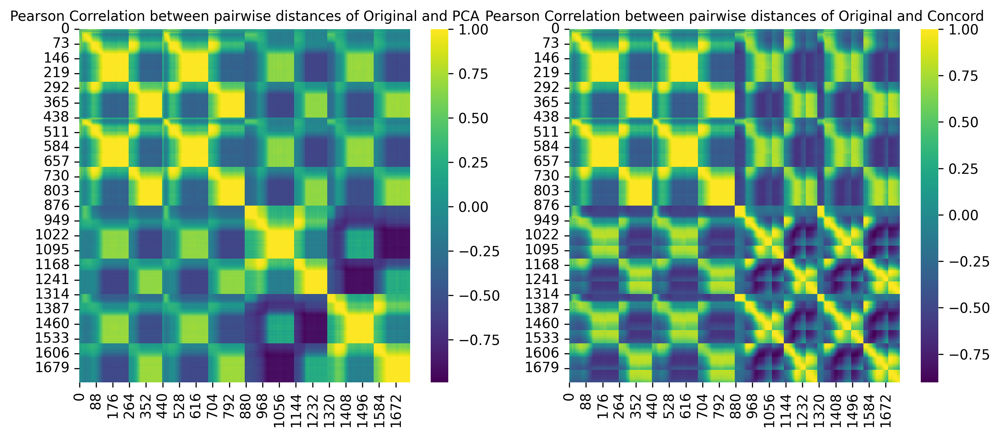

In [125]:
# Visualize Pearson correlation as heatmap
import seaborn as sns
corr_concord = np.corrcoef(squareform(dist_original), squareform(dist_concord))
corr_batch = np.corrcoef(squareform(dist_original), squareform(dist_pca))

fig, axes = plt.subplots(1, 2, figsize=(10, 4.5), dpi=300)
sns.heatmap(corr_batch, cmap='viridis', ax=axes[0])
axes[0].set_title(f'Pearson Correlation between pairwise distances of Original and PCA', fontsize=10)
sns.heatmap(corr_concord, cmap='viridis', ax=axes[1])
axes[1].set_title(f'Pearson Correlation between pairwise distances of Original and Concord', fontsize=10)
plt.tight_layout()
plt.savefig(save_dir / f"{dist_metric}_distance_pearson_corr_heatmaps_{file_suffix}.png")

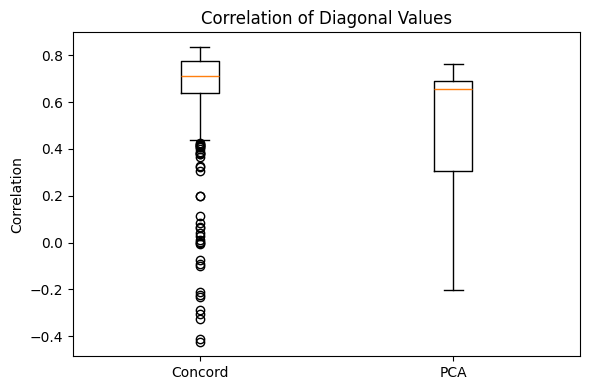

In [126]:
# Extract diagonal from the top-right or bottom-left n x n block

def extract_correlation_diagonal(cor_mtx):
    n = cor_mtx.shape[0]//2

    off_diagonal_block = cor_mtx[:n, n:]  # top-right block

    # Calculate the mean of the diagonal values in the off-diagonal block
    diagonal_correlation = np.diag(off_diagonal_block)
    average_correlation = np.mean(diagonal_correlation)

    return diagonal_correlation, average_correlation

corr_concord_diag, corr_concord_avg = extract_correlation_diagonal(corr_concord)
corr_pca_diag, corr_pca_avg = extract_correlation_diagonal(corr_batch)

# Visualize the correlation of the diagonal values between concord and pca with boxplot colored by group
import matplotlib.pyplot as plt

fig = plt.figure(figsize=(6, 4), dpi=100)
plt.boxplot([corr_concord_diag, corr_pca_diag], labels=['Concord', 'PCA'])
plt.ylabel('Correlation')
plt.title('Correlation of Diagonal Values')
plt.tight_layout()
plt.savefig(save_dir / f"distance_spearman_corr_diagonal_{file_suffix}.png")

**Mantel test**

In [30]:
from skbio.stats.distance import mantel
from scipy.spatial.distance import pdist, squareform

# Perform Mantel test
corr_sp_ccd, p_sp_ccd, _ = mantel(dist_original, dist_concord, method='spearman')
corr_sp_pca, p_sp_pca, _ = mantel(dist_original, dist_pca, method='spearman')
corr_pr_ccd, p_pr_ccd, _ = mantel(dist_original, dist_concord, method='pearson')
corr_pr_pca, p_pr_pca, _ = mantel(dist_original, dist_pca, method='pearson')

print(f'Mantel Test: Spearman Correlation: Concord: {corr_sp_ccd:.2f}, PCA: {corr_sp_pca:.2f}; p-value: Concord: {p_sp_ccd}, PCA: {p_sp_pca}')
print(f'Mantel Test: Pearson Correlation: Concord: {corr_pr_ccd:.2f}, PCA: {corr_pr_pca:.2f}; p-value: Concord: {p_pr_ccd}, PCA: {p_pr_pca}')


Mantel Test: Spearman Correlation: Concord: 0.59, PCA: 0.53; p-value: Concord: 0.001, PCA: 0.001
Mantel Test: Pearson Correlation: Concord: 0.61, PCA: 0.49; p-value: Concord: 0.001, PCA: 0.001


#### 2.3 Local vs distal Spearman correlation

In [31]:
from scipy.spatial.distance import pdist, squareform
from scipy.stats import spearmanr
import numpy as np

def local_vs_distal_spearman(X_high, X_low, local_percentile=25, distal_percentile=75, method='spearman'):
    # Step 1: Compute pairwise distances
    dist_high = pdist(X_high)  # Original space distances
    dist_low = pdist(X_low)    # Latent space distances

    # Step 2: Define a threshold based on the specified percentile
    distance_threshold_local = np.percentile(dist_high, local_percentile)
    distance_threshold_distal = np.percentile(dist_high, distal_percentile)

    # Step 3: Separate distances into local and distal categories
    local_mask = dist_high <= distance_threshold_local
    distal_mask = dist_high > distance_threshold_distal

    # Step 4: Compute Spearman correlations for local and distal distances
    if method == 'spearman':
        local_spearman, _ = spearmanr(dist_high[local_mask], dist_low[local_mask])
        distal_spearman, _ = spearmanr(dist_high[distal_mask], dist_low[distal_mask])
    elif method == 'pearson':
        local_spearman, _ = pearsonr(dist_high[local_mask], dist_low[local_mask])
        distal_spearman, _ = pearsonr(dist_high[distal_mask], dist_low[distal_mask])

    return local_spearman, distal_spearman

# Example usage
local_sp_ccd, distal_sp_ccd = local_vs_distal_spearman(adata_state.X, adata.obsm['Concord'], method='spearman')
local_sp_pca, distal_sp_pca = local_vs_distal_spearman(adata_state.X, adata.obsm['X_pca'], method='spearman')
print(f'Local Spearman Correlation: Concord: {local_sp_ccd:.4f}, PCA: {local_sp_pca:.4f}')
print(f'Distal Spearman Correlation: Concord: {distal_sp_ccd:.4f}, PCA: {distal_sp_pca:.4f}')
local_pr_ccd, distal_pr_ccd = local_vs_distal_spearman(adata_state.X, adata.obsm['Concord'], method='pearson')
local_pr_pca, distal_pr_pca = local_vs_distal_spearman(adata_state.X, adata.obsm['X_pca'], method='pearson')
print(f'Local Pearson Correlation: Concord: {local_pr_ccd:.4f}, PCA: {local_pr_pca:.4f}')
print(f'Distal Pearson Correlation: Concord: {distal_pr_ccd:.4f}, PCA: {distal_pr_pca:.4f}')

Local Spearman Correlation: Concord: 0.7421, PCA: 0.4521
Distal Spearman Correlation: Concord: 0.6080, PCA: 0.4909
Local Pearson Correlation: Concord: 0.6766, PCA: 0.2109
Distal Pearson Correlation: Concord: 0.5718, PCA: 0.3602


#### 2.4 Trustworthiness (Local neighborhood/structure preservation)

In [32]:
from sklearn.manifold import trustworthiness

n_neighbors = 10  # Adjust as needed

trust_ccd_batch = trustworthiness(adata.X, adata.obsm['Concord'], n_neighbors=n_neighbors)
trust_pca_batch = trustworthiness(adata.X, adata.obsm['X_pca'], n_neighbors=n_neighbors)
trust_ccd_state = trustworthiness(adata_state.X, adata.obsm['Concord'], n_neighbors=n_neighbors)
trust_pca_state = trustworthiness(adata_state.X, adata.obsm['X_pca'], n_neighbors=n_neighbors)

print(f"Trustworthiness of Concord vs batch data: {trust_ccd_batch}")
print(f"Trustworthiness of PCA vs batch data: {trust_pca_batch}")
print(f"Trustworthiness of Concord vs state data: {trust_ccd_state}")
print(f"Trustworthiness of PCA vs state data: {trust_pca_state}")

Trustworthiness of Concord vs batch data: 0.8744778623777036
Trustworthiness of PCA vs batch data: 0.9990604121658633
Trustworthiness of Concord vs state data: 0.9812071771183041
Trustworthiness of PCA vs state data: 0.9922705906342418


In [33]:
# Plot trustworthiness as a function of number of neighbors
import numpy as np
import matplotlib.pyplot as plt

n_neighbors = np.arange(10, 400, 10)
trust_ccd = [trustworthiness(adata_state.X, adata.obsm['Concord'], n_neighbors=n) for n in n_neighbors]
trust_pca = [trustworthiness(adata_state.X, adata.obsm['X_pca'], n_neighbors=n) for n in n_neighbors]


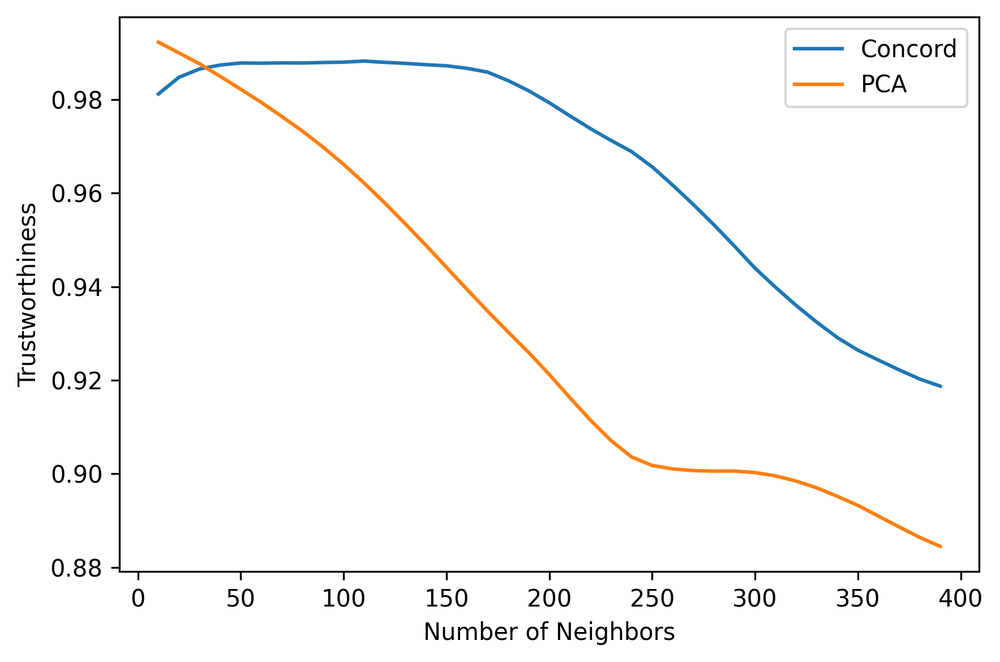

In [34]:
# Plot trustworthiness as a function of number of neighbors
plt.figure(figsize=(6, 4), dpi=300)
plt.plot(n_neighbors, trust_ccd, label='Concord')
plt.plot(n_neighbors, trust_pca, label='PCA')
plt.xlabel('Number of Neighbors')
plt.ylabel('Trustworthiness')
plt.legend()
plt.tight_layout()

plt.savefig(save_dir / f"trustworthiness_{file_suffix}.png")


### Show preservation of distance at cluster level

In [94]:
adata.obs

,branch,depth,batch,leiden,leiden_concord
cell_0,root,2,batch_1,6,1
cell_2,root,2,batch_1,6,1
cell_3,root,2,batch_1,6,1
cell_5,root,2,batch_1,6,1
cell_6,root,2,batch_1,6,1
...,...,...,...,...,...
cell_865,1_1,0,batch_2,3,9
cell_866,1_1,0,batch_2,3,9
cell_869,1_1,0,batch_2,3,9
cell_870,1_1,0,batch_2,3,9


In [93]:
import pandas as pd
from scipy.spatial.distance import pdist
from scipy.spatial.distance import squareform
adata_state.obs['leiden_concord'] = adata.obs['leiden_concord']

# Define function to compute centroid distances
def compute_centroid_distance(adata, basis, group_key):
    # Convert embedding data to DataFrame and align with observations
    embedding_df = pd.DataFrame(adata.obsm[basis], index=adata.obs.index)
    # Compute centroids by grouping based on the specified group_key
    centroids = embedding_df.groupby(adata.obs[group_key]).mean()
    # Calculate pairwise distances between centroids
    dist = pdist(centroids, metric='cosine')
    return dist

# Compute centroid distances for original PCA, Concord, and PCA again as required
dist_leiden_original = compute_centroid_distance(adata_state, 'X_pca', 'leiden_concord')
dist_leiden_concord = compute_centroid_distance(adata, 'Concord', 'leiden_concord')
dist_leiden_pca = compute_centroid_distance(adata, 'X_pca', 'leiden_concord')

# Optional: Convert distances to a square form for easier interpretation
dist_leiden_original_matrix = squareform(dist_leiden_original)
dist_leiden_concord_matrix = squareform(dist_leiden_concord)
dist_leiden_pca_matrix = squareform(dist_leiden_pca)


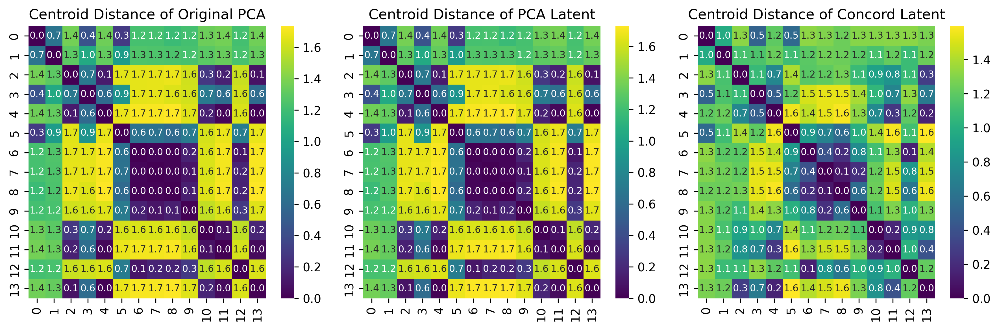

In [100]:
fig, axes = plt.subplots(1, 3, figsize=(12, 4), dpi=300)
sns.heatmap(dist_leiden_original_matrix, cmap='viridis', ax=axes[0], annot=True, fmt=".1f", annot_kws={"fontsize":8})
axes[0].set_title(f'Centroid Distance of Original PCA')
sns.heatmap(dist_leiden_pca_matrix, cmap='viridis', ax=axes[1], annot=True, fmt=".1f", annot_kws={"fontsize":8})
axes[1].set_title(f'Centroid Distance of PCA Latent')
sns.heatmap(dist_leiden_concord_matrix, cmap='viridis', ax=axes[2], annot=True, fmt=".1f", annot_kws={"fontsize":8})
axes[2].set_title(f'Centroid Distance of Concord Latent')
plt.tight_layout()
plt.savefig(save_dir / f"centroid_distance_heatmaps_{file_suffix}.png")


In [102]:
# Correlation of the rank matrices
from scipy.stats import spearmanr
corr_original_concord, _ = spearmanr(rank_original.ravel(), rank_concord.ravel())
corr_original_pca, _ = spearmanr(rank_original.ravel(), rank_pca.ravel())
corr_original_concord, corr_original_pca

(0.8697017268445839, 0.9959183673469387, 0.5773809523809523)

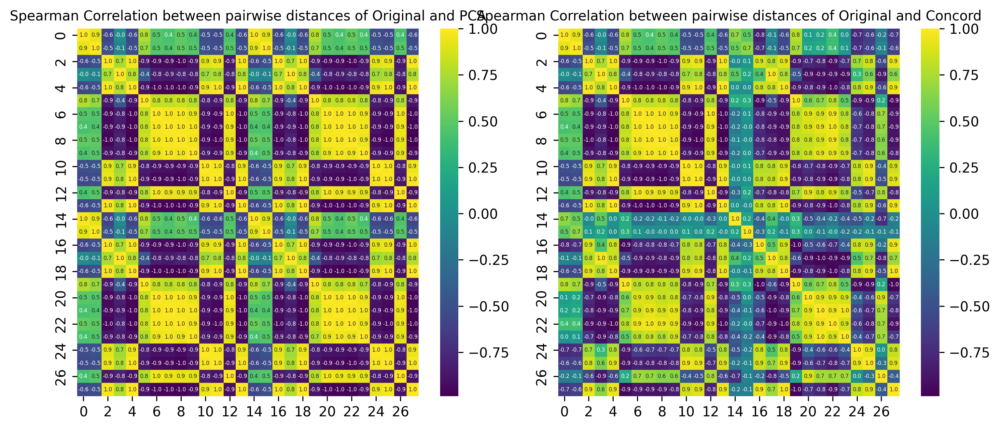

In [105]:
corr_leiden_concord, _ = spearmanr(dist_leiden_original_matrix, dist_leiden_concord_matrix)
corr_leiden_pca, _ = spearmanr(dist_leiden_original_matrix, dist_leiden_pca_matrix)

fig, axes = plt.subplots(1, 2, figsize=(10, 4.5), dpi=300)
sns.heatmap(corr_leiden_pca, cmap='viridis', ax=axes[0], annot=True, fmt=".1f", annot_kws={"fontsize":4})
axes[0].set_title(f'Spearman Correlation between pairwise distances of Original and PCA', fontsize=10)
sns.heatmap(corr_leiden_concord, cmap='viridis', ax=axes[1], annot=True, fmt=".1f", annot_kws={"fontsize":4})
axes[1].set_title(f'Spearman Correlation between pairwise distances of Original and Concord', fontsize=10)
plt.tight_layout()
plt.savefig(save_dir / f"leiden_distance_spearman_corr_heatmaps_{file_suffix}.png")

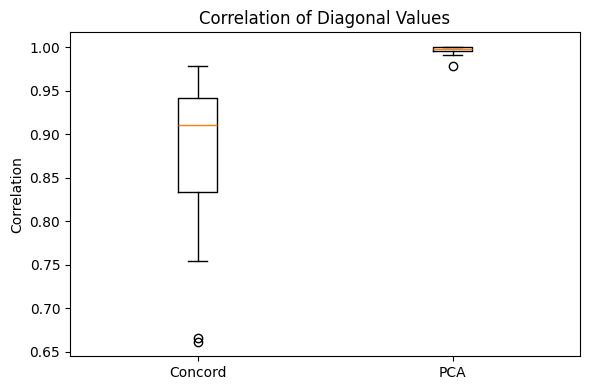

In [110]:
# Extract diagonal from the top-right or bottom-left n x n block

def extract_correlation_diagonal(cor_mtx):
    n = cor_mtx.shape[0]//2

    off_diagonal_block = cor_mtx[:n, n:]  # top-right block

    # Calculate the mean of the diagonal values in the off-diagonal block
    diagonal_correlation = np.diag(off_diagonal_block)
    average_correlation = np.mean(diagonal_correlation)

    return diagonal_correlation, average_correlation

corr_leiden_concord_diag, corr_leiden_concord_avg = extract_correlation_diagonal(corr_leiden_concord)
corr_leiden_pca_diag, corr_leiden_pca_avg = extract_correlation_diagonal(corr_leiden_pca)

# Visualize the correlation of the diagonal values between concord and pca with boxplot colored by group
import matplotlib.pyplot as plt

fig = plt.figure(figsize=(6, 4), dpi=100)
plt.boxplot([corr_leiden_concord_diag, corr_leiden_pca_diag], labels=['Concord', 'PCA'])
plt.ylabel('Correlation')
plt.title('Correlation of Diagonal Values')
plt.tight_layout()
plt.savefig(save_dir / f"leiden_distance_spearman_corr_diagonal_{file_suffix}.png")


